<a href="https://colab.research.google.com/github/pratikshinde749/EDA-Global-Terrorism/blob/main/EDA_Global_Terrorism_by_Pratik_Shinde_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Project Name**    - Understanding Global Terrorism Patterns



##### **Project Type**    - EDA
##### **Contribution**    - Individual
##### **Name**            - Pratik shinde    

# **Project Summary -**

**The Global Terrorism Database (GTD) is an open-source database including information on terrorist attacks around the world from 1970 through 2017. The GTD includes systematic data on domestic as well as international terrorist incidents that have occurred during this time period and now includes more than 180,000 attacks. The database is maintained by researchers at the National Consortium for the Study of Terrorism and Responses to Terrorism (START), headquartered at the University of Maryland. Explore and analyze the data to discover key findings pertaining to terrorist activities.**

---

# **GitHub Link -**

Provide your GitHub Link here.

---

# **Problem Statement**


**The Global Terrorism Database (GTD) is an open-source database including information on terrorist attacks around the world from 1970 through 2017. The GTD includes systematic data on domestic as well as international terrorist incidents that have occurred during this time period and now includes more than 180,000 attacks. The database is maintained by researchers at the National Consortium for the Study of Terrorism and Responses to Terrorism (START), headquartered at the University of Maryland. Explore and analyze the data to discover key findings pertaining to terrorist activities.**

---

#### **Define Your Business**

**The primary  objective is to improve understanding and awareness of global terrorism patterns and dynamics. By analyzing the dataset and visualizing trends, we aim to identify key factors and patterns that contribute to terrorist activities worldwide. This understanding can inform policymakers, security agencies, and the public, enabling them to develop more effective strategies for prevention, response, and counter-terrorism efforts.**

---

# ***Let's Begin !***

## ***1. Know Your Data***

### Import Libraries

In [ ]:
# Import Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import calendar
import plotly.express as px

### Dataset Loading

In [ ]:
# Load Dataset
from google.colab import drive
drive.mount("/content/drive")

path="/content/drive/MyDrive/Datasets/Global_Terrorism_Data.csv"


Mounted at /content/drive


### Dataset First View

In [ ]:
encodings = ['utf-8', 'latin1', 'ISO-8859-1', 'utf-16']
for encoding in encodings:
    try:
        df = pd.read_csv(path, encoding=encoding)
        print("CSV file read successfully using encoding:", encoding)
        break
    except UnicodeDecodeError:
        print("Error decoding with encoding:", encoding)



Error decoding with encoding: utf-8
CSV file read successfully using encoding: latin1


In [ ]:
# Display the first few rows of the DataFrame
df.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


### **The dataset is too big and contains extra columns we will filter the columns first**

In [ ]:

df.rename(columns={'iyear':'Year','imonth':'Month','iday':'Day','country_txt':'Country','region_txt':'Region','attacktype1_txt':'AttackType','target1':'Target','nkill':'Killed','nwound':'Wounded','summary':'Summary','gname':'Group','targtype1_txt':'Target_type','weaptype1_txt':'Weapon_type','motive':'Motive'},inplace=True)
terror=df[['Year','Month','Day','Country','Region','city','latitude','longitude','AttackType','Killed','Wounded','Target','Summary','Group','Target_type','Weapon_type','Motive']]
terror['casualities']=terror['Killed']+terror['Wounded']

### Dataset Rows & Columns count

In [ ]:
# Dataset Rows & Columns count
terror.shape

(181691, 18)

### Dataset Information

In [ ]:
# Dataset Info
terror.info()

#### Duplicate Values

In [ ]:
# Dataset Duplicate Value Count
terror.duplicated().sum()

9515

#### Missing Values/Null Values

In [ ]:
# Missing Values/Null Values Count
terror.isnull().sum()


<Axes: >

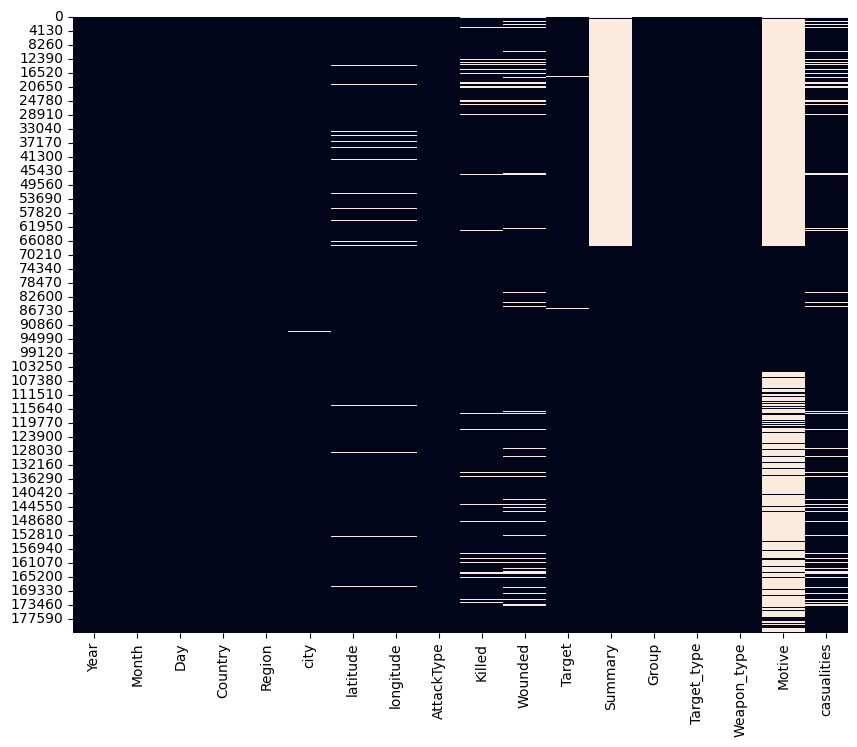

In [ ]:
# Visualizing the missing values
plt.figure(figsize=(10,8))
sns.heatmap(terror.isnull(), cbar=False)

### What did you know about your dataset?

The dataset consists of 181,691 entries and 18 columns. Each entry represents a terrorist attack and contains information such as the year, month, and day of the attack, the country and region where it occurred, details about the attack type, casualties (killed and wounded), target of the attack, the group responsible, weapon type used, and motives behind the attacks.

---

## ***2. Understanding Your Variables***

In [ ]:
# Dataset Columns
terror.columns

Index(['Year', 'Month', 'Day', 'Country', 'Region', 'city', 'latitude',
       'longitude', 'AttackType', 'Killed', 'Wounded', 'Target', 'Summary',
       'Group', 'Target_type', 'Weapon_type', 'Motive', 'casualities'],
      dtype='object')

In [ ]:
# Dataset Describe
terror.describe(include='all')

----

### Variables Description

1. Year: Represents the year in which the terrorist attack occurred.

2. Month: Indicates the month of the attack.

3. Day: Specifies the day of the attack.

4. Country: Denotes the country where the terrorist attack took place.

5. Region: Indicates the region within the country where the attack occurred.

6. City: Represents the city where the attack occurred.

7. Latitude and Longitude: Provide geographical coordinates of the location where the attack took place.

8. AttackType: Describes the type of attack carried out by the terrorists (e.g., bombing, armed assault, assassination).

9. Killed: Indicates the number of people killed in the attack.

10. Wounded: Specifies the number of people wounded in the attack.

11. Target: Describes the target of the attack (e.g., civilians, government officials, military personnel).

12. Summary: Provides a summary of the attack or its aftermath.

13. Group: Represents the terrorist group responsible for carrying out the attack.

14. Target_type: Classifies the type of target attacked (e.g., private citizens, government, military).

15. Weapon_type: Specifies the type of weapon used in the attack (e.g., explosives, firearms, melee weapons).

16. Motive: Provides information about the motive behind the attack, where available.

17. Casualties: Represents the total number of casualties (killed and wounded) in the attack.



---


In [ ]:
# Check Unique Values for each variable.
for col in terror.describe(include='object').columns:
  print(col)
  print(f"{terror[col].unique()}")
  print("-"*75)

------

## ***4. Data Vizualization, Storytelling & Experimenting with charts : Understand the relationships between variables***

## **Analyzing Trends in Terrorist Attacks Over Time**

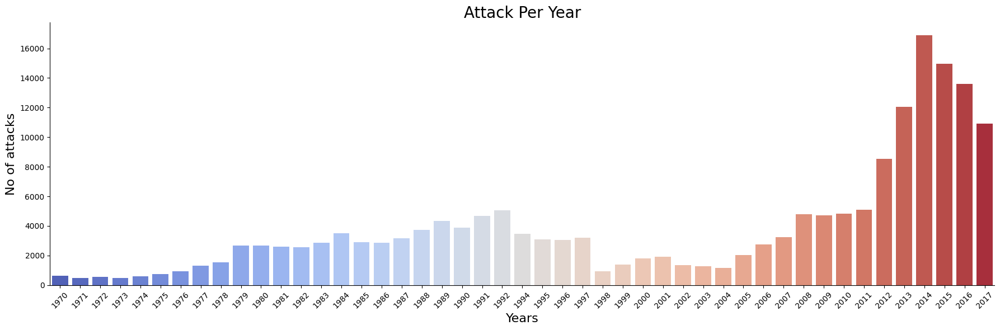

In [ ]:
year_attack=terror['Year'].value_counts()
plt.figure(figsize=(18,6))
sns.barplot(x=year_attack.index, y=year_attack, palette='coolwarm')
plt.xticks(rotation=45)
plt.title('Attack Per Year',fontsize=20)
plt.xlabel('Years',fontsize=16)
plt.ylabel('No of attacks',fontsize=16)
sns.despine()
plt.tight_layout()
plt.show()


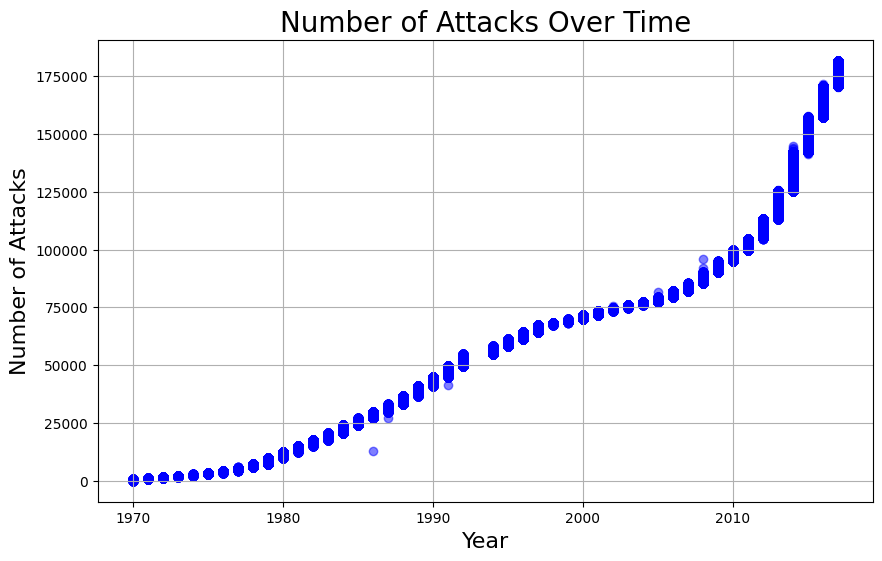

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(terror['Year'], terror.index, color='blue', alpha=0.5)
plt.title('Number of Attacks Over Time',fontsize=20)
plt.xlabel('Year',fontsize=16)
plt.ylabel('Number of Attacks',fontsize=16)
plt.grid(True)
plt.show()

**The number of terrorist attacks has fluctuated over the years.                 
 There is a noticeable increase in attacks from the late 2000s onwards.   
 Highest number of attack happened in the year 2014,2015,2016 consecutively**

---

## **Unveiling the Casualties Ratio per Year**

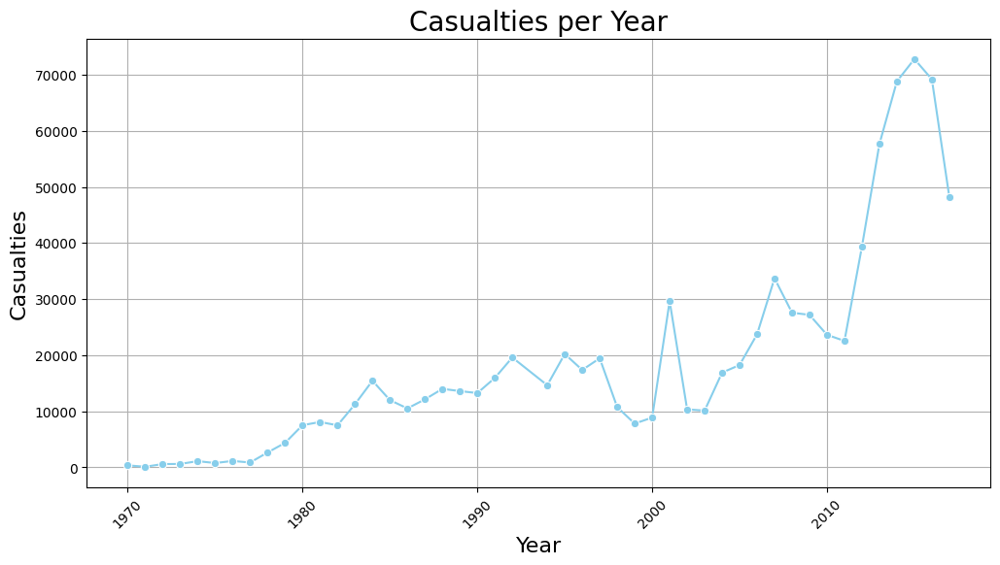

In [ ]:
casualties_per_year = terror.groupby('Year')['casualities'].sum()
plt.figure(figsize=(12, 6))
sns.lineplot(x=casualties_per_year.index, y=casualties_per_year, marker='o', color='skyblue')
plt.title('Casualties per Year',fontsize=20)
plt.xlabel('Year',fontsize=16)
plt.ylabel('Casualties',fontsize=16)
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

**As the number of attacks increased from the late 2000s onwards, so did the number of casualties and peaked at nearby year 2014,2015.**

****

## **Terror Attacks based on Months**

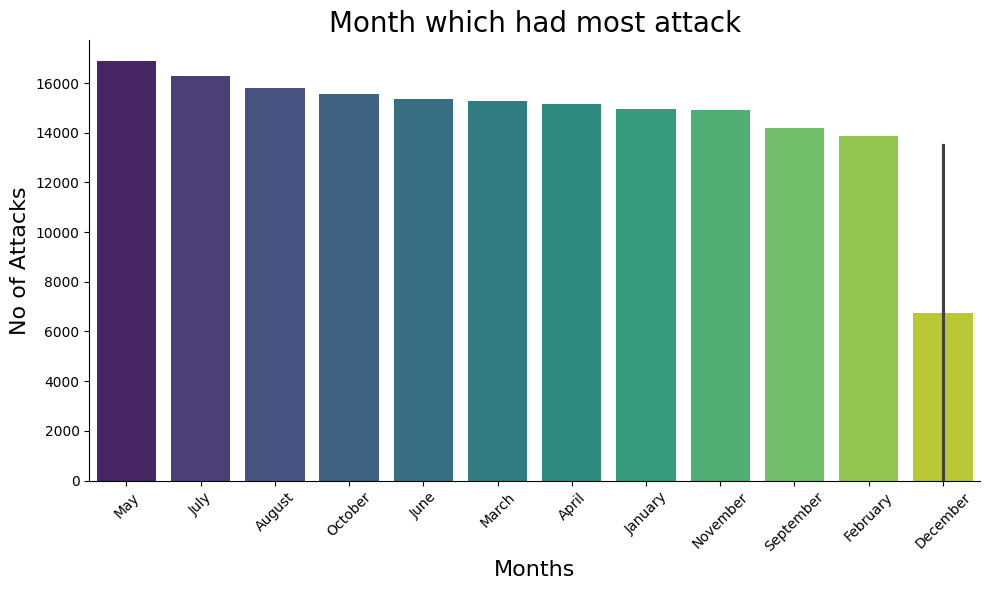

In [ ]:
month_names = [calendar.month_name[i] for i in range(1, 13)]
month_attack=terror['Month'].value_counts()
plt.figure(figsize=(10,6))
sns.barplot(x=month_attack.index.map(lambda x: month_names[x-1]), y=month_attack, palette='viridis')
plt.xticks(rotation=45)
plt.title('Month which had most attack',fontsize=20)
plt.xlabel('Months',fontsize=16)
plt.ylabel('No of Attacks',fontsize=16)
sns.despine()
plt.tight_layout()
plt.show()

**The highest number of attacks occurred in May, July, and August, with significantly fewer attacks in December.**

---

## **"What Methods Were Used in the Attack?"**

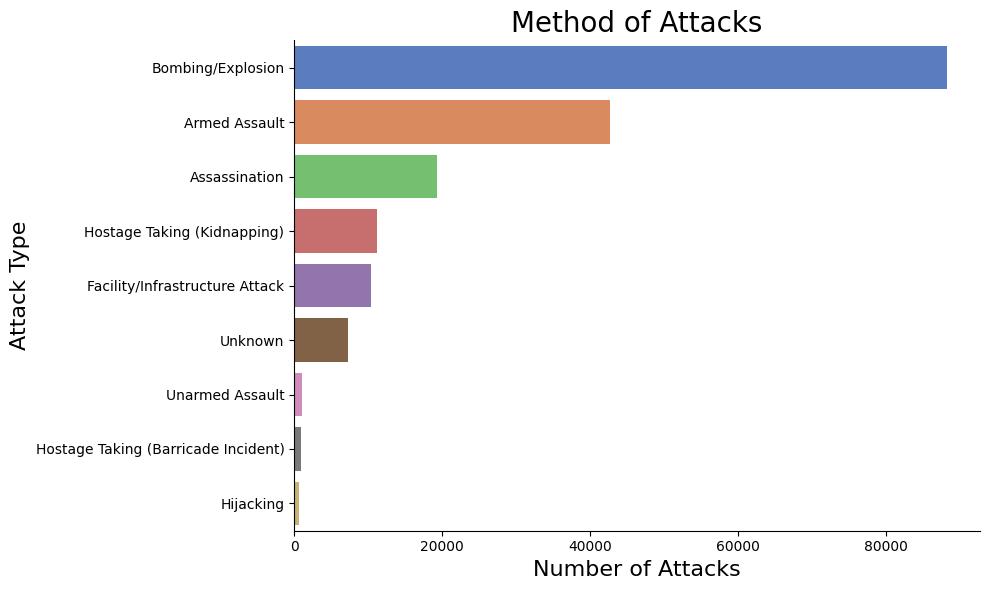

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(y=terror['AttackType'], order=terror['AttackType'].value_counts().index, palette='muted')
plt.title('Method of Attacks',fontsize=20)
plt.xlabel('Number of Attacks',fontsize=16)
plt.ylabel('Attack Type',fontsize=16)
sns.despine()
plt.tight_layout()
plt.show()

**Bombings are the most prevalent method used in terrorist attacks, followed by armed assaults and assassinations.**

---

## **Weapon Used for Attacks.**

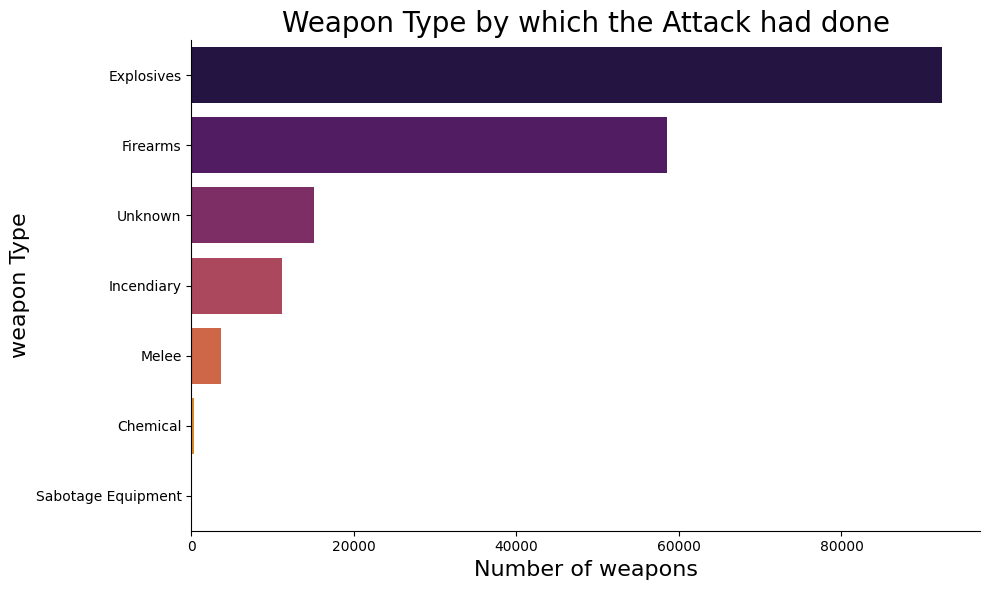

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(y=terror['Weapon_type'], order=terror['Weapon_type'].value_counts()[0:7].index, palette='inferno')
plt.title('Weapon Type by which the Attack had done',fontsize=20)
plt.xlabel('Number of weapons',fontsize=16)
plt.ylabel('weapon Type',fontsize=16)
sns.despine()
plt.tight_layout()
plt.show()

**Explosives and firearms are the most commonly used weapons in terrorist attacks.**

---

## **The Most Frequently Targeted Area by Terrorists**

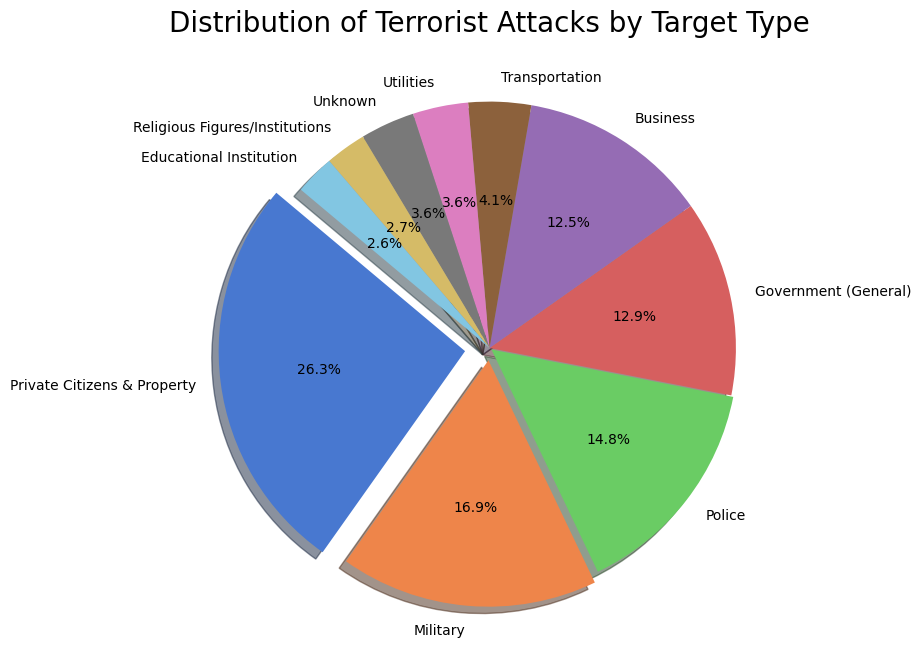

In [ ]:
plt.figure(figsize=(10, 8))
explode = (0.1, 0.05, 0.01, 0, 0, 0, 0, 0, 0, 0)
target_type_counts = terror['Target_type'].value_counts().head(10)
target_type_counts.plot.pie(autopct='%1.1f%%', startangle=140,shadow=True,explode=explode)
plt.title('Distribution of Terrorist Attacks by Target Type',fontsize=20)
plt.ylabel('')
plt.show()

**The Most Frequently Target type by terrorist are Private Citizens/Property, Military followed by Police and Government.**

---

## **Who are Responsible for these Attacks ?**

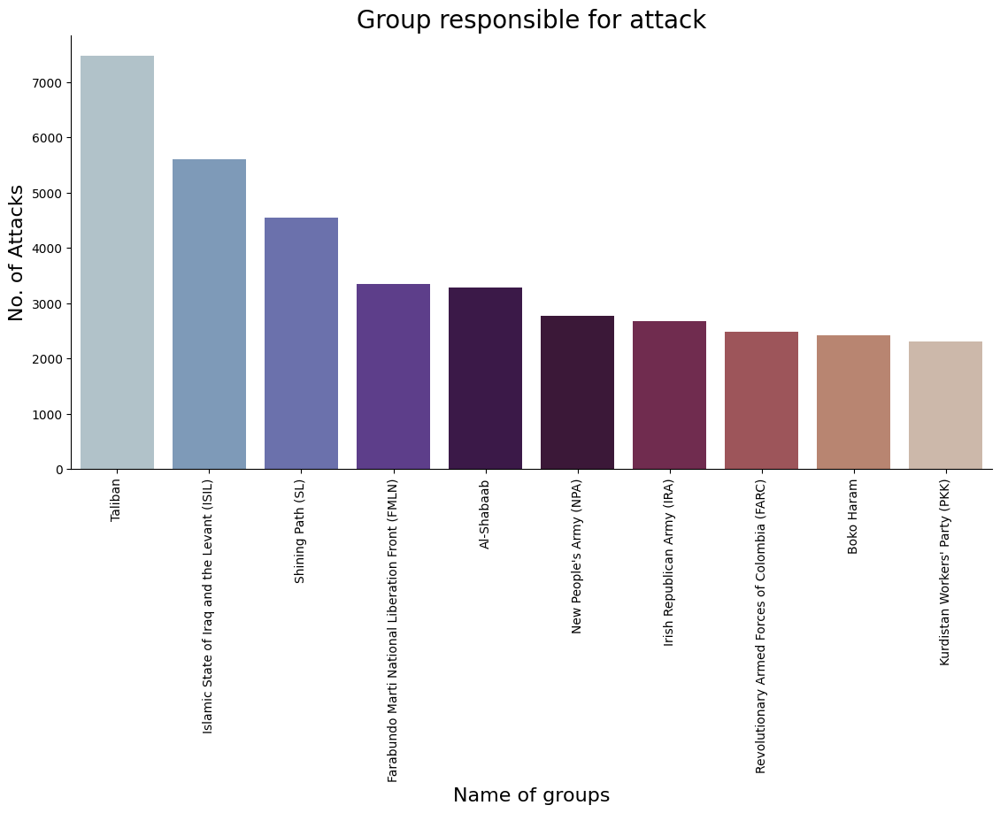

In [ ]:
terror_group=terror['Group'].value_counts()[1:11]
plt.figure(figsize=(12, 6))
sns.barplot(x=terror_group.index,y=terror_group,palette='twilight')
plt.title('Group responsible for attack',fontsize=20)
plt.xlabel('Name of groups',fontsize=16)
plt.ylabel('No. of Attacks',fontsize=16)
sns.despine()
plt.tight_layout()
plt.xticks(rotation=90)
plt.show()

**The most are done by the groups like 'Taliban' followed by 'Islamic state if Iraq and the Levant'(ISIL) and 'Shining Path'(SL)**

---

## **Countries That suffer the most due to these Attacks.**

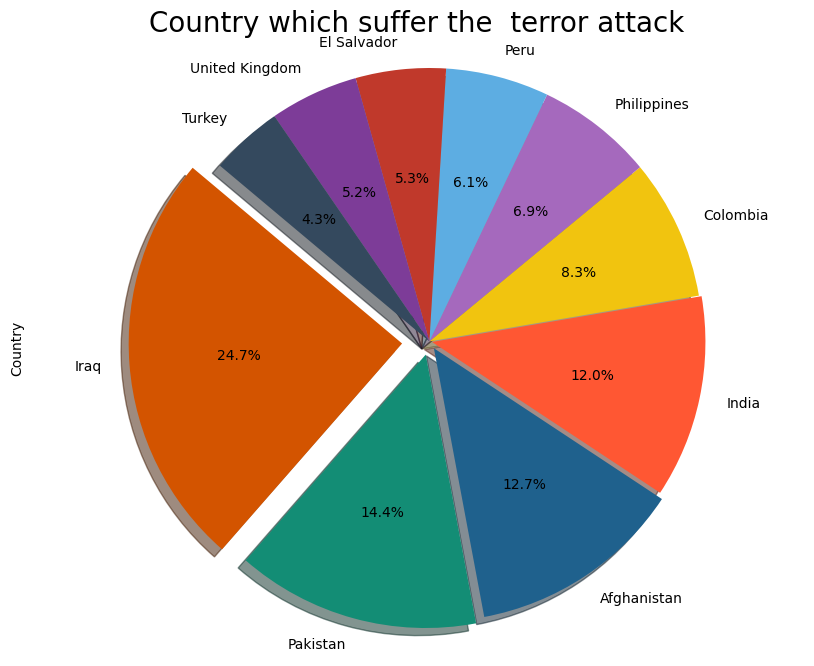

In [ ]:
plt.figure(figsize=(10, 8))
explode = (0.1, 0.05, 0.03, 0.01, 0, 0, 0, 0, 0, 0)
color = ['#34495E', '#7D3C98', '#C0392B', '#5DADE2', '#A569BD', '#F1C40F', '#FF5733', '#1F618D', '#138D75', '#D35400']
colors=color[::-1]
terror['Country'].value_counts().head(10).plot.pie(autopct='%1.1f%%',colors=colors,shadow=True,explode=explode,startangle=140)
plt.axis('equal')
plt.title('Country which suffer the  terror attack',fontsize=20)

plt.show()

**Iraq, Pakistan, Afghanistan followed by India and Colombia suffer the most**

---

## **Countries with the Highest Attack Counts vs Fatalities**

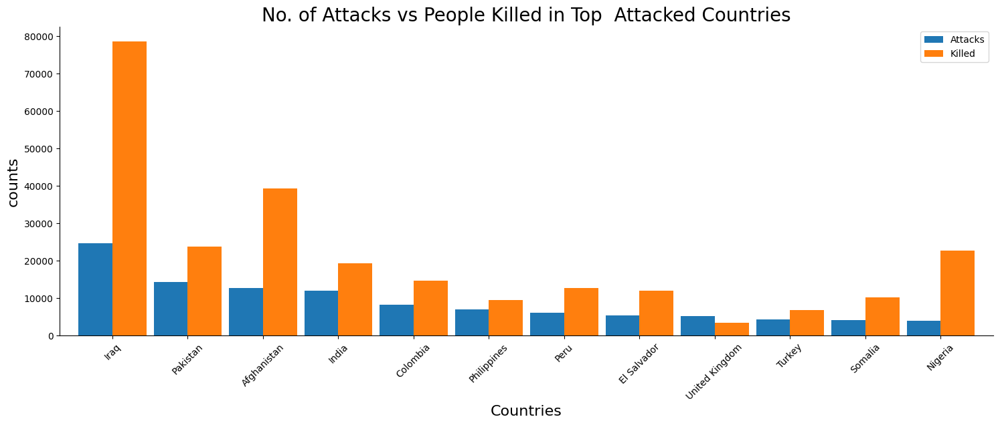

In [ ]:
coun_terror = terror['Country'].value_counts()[:12].to_frame()
coun_terror.columns = ['Attacks']

coun_kill = terror.groupby('Country')['Killed'].sum().to_frame()

merged_data = coun_terror.merge(coun_kill, left_index=True, right_index=True, how='left')
merged_data.plot(kind='bar', y=['Attacks', 'Killed'], width=0.9, figsize=(18, 6))
plt.title('No. of Attacks vs People Killed in Top  Attacked Countries',fontsize=20)
plt.xticks(rotation=45)
plt.xlabel('Countries',fontsize=16)
plt.ylabel('counts',fontsize=16)
sns.despine()
plt.show()

**Iraq has the most killed people as the Attacks are more,  
But compared to the attacks on Pakistan and Afghanistan, Afghanistan has more people killed.
Surprisingly Nigeria has more killed people than India and respective countries**

---

## **The number of casulties in top attack country**

In [ ]:
top_10_countries = terror.groupby('Country')['Killed', 'Wounded'].sum().sort_values(by='Killed', ascending=False).head(10)


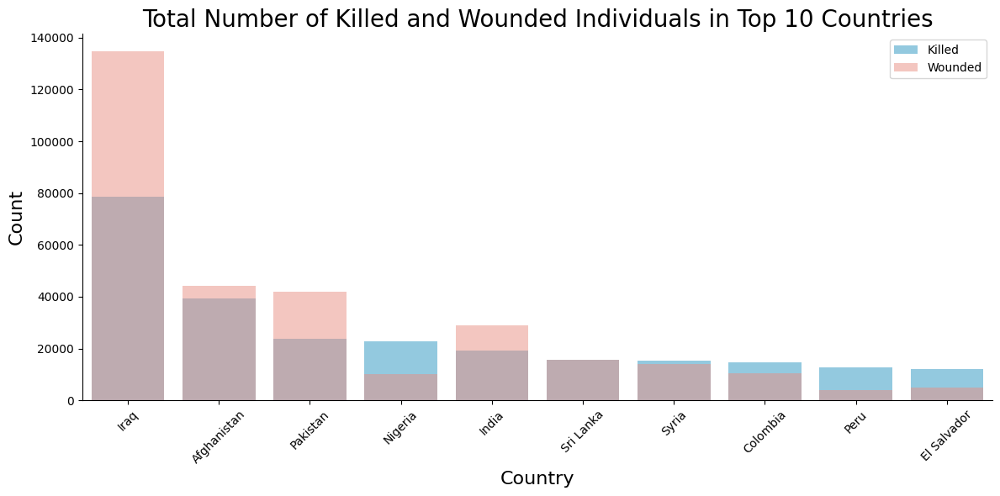

In [ ]:
plt.figure(figsize=(12, 6))
sns.barplot(x=top_10_countries.index, y=top_10_countries['Killed'], color='skyblue', label='Killed')
sns.barplot(x=top_10_countries.index, y=top_10_countries['Wounded'], color='salmon', label='Wounded', alpha=0.5)

plt.xlabel('Country', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.title('Total Number of Killed and Wounded Individuals in Top 10 Countries', fontsize=20)
plt.xticks(rotation=45)
plt.legend()
sns.despine()
plt.tight_layout()
plt.show()

**Iraq, Afghanistan, Pakistan and India have more people wounded than Killed But the countries like Nigeria,Colombia, Peru and El Salvador has more people killed than wounded.**

---

## **Region in which Most Attacks Occurred**

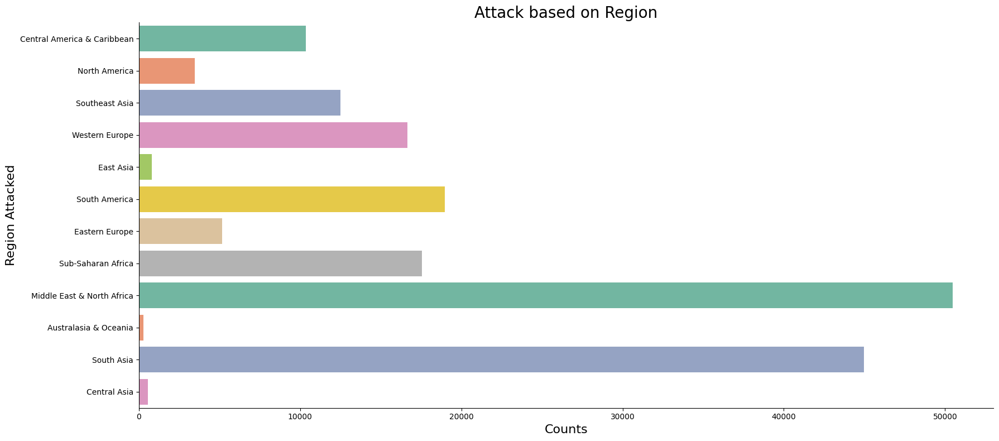

In [ ]:

plt.figure(figsize=(18,8))
sns.countplot(terror['Region'],palette='Set2')
plt.title('Attack based on Region',fontsize=20)
plt.xlabel('Counts',fontsize=16)
plt.ylabel('Region Attacked',fontsize=16)
sns.despine()
plt.tight_layout()
plt.show()

**The region of Middle East & North Africa, South Asia, South America, Western Europe and sub-Saharan Africa have more attack occured.**

---

## **Preferred attack type by Region**

<Figure size 1200x800 with 0 Axes>

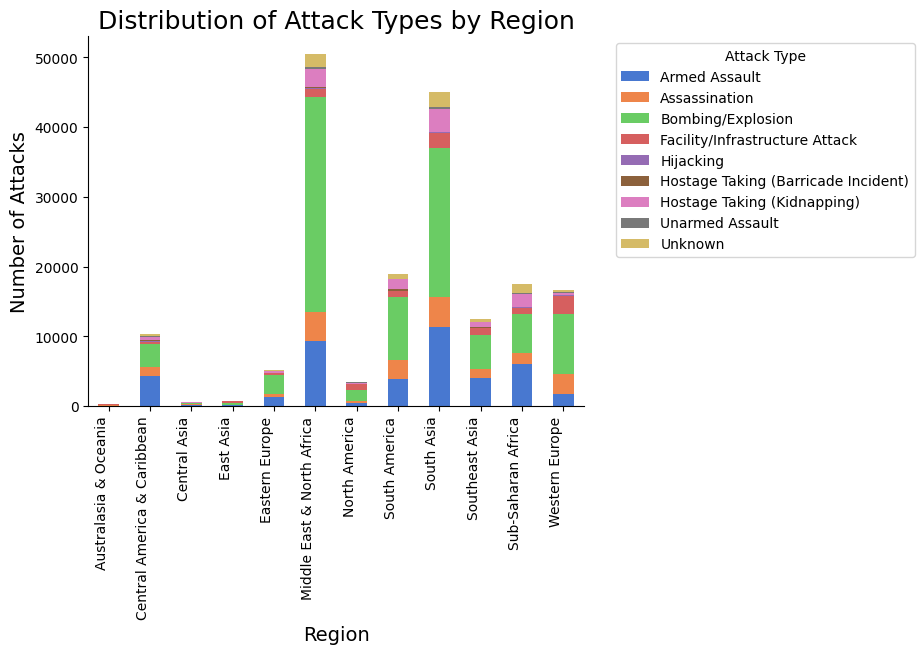

In [ ]:
plt.figure(figsize=(12, 8))
attack_region = pd.crosstab(terror['Region'], terror['AttackType'])
sns.set_palette('muted')  # Set color palette
ax = attack_region.plot(kind='bar', stacked=True)

plt.title('Distribution of Attack Types by Region', fontsize=18)
plt.xlabel('Region', fontsize=14)
plt.ylabel('Number of Attacks', fontsize=14)

plt.xticks(rotation=90, ha='right', fontsize=10)
sns.despine()
plt.legend(title='Attack Type', bbox_to_anchor=(1.05, 1), loc='upper left',fontsize='medium')
plt.show()

**The Middle East and North Africa region has the highest number of bombings compared to other regions, South Asia exhibits a significant proportion of armed assault attacks.     
Europe shows a relatively lower frequency of bombings and armed assaults compared to other regions, with a higher proportion of hijackings and hostage-taking incidents.**

---

## **Global Terrorism Incidents: Visualizing Attacks Worldwide**

In [ ]:
hover_text = terror.apply(lambda row: f'In year {row["Year"]} an Attack on {row["Country"]} in {row["city"]} happened by {row["Group"]} in which {row["casualities"]} casualties were there', axis=1)

fig = px.scatter_mapbox(terror, lat='latitude', lon='longitude', hover_name=hover_text, zoom=1, height=600)
fig.update_layout(title='Global Terrorism Incidents')
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()


**The scatter mapbox plot provides a comprehensive view of global terrorism incidents, with each point representing a specific attack .
By hovering over each point, users can access detailed information such as the year, location, perpetrating group, and casualties of the attack.**

---

## **The world heat map on terrorism in countries.**

In [ ]:
attack_counts = terror['Country'].value_counts().reset_index()
attack_counts.columns = ['country', 'attack_count']

fig = px.choropleth(attack_counts,
                    locations="country",
                    locationmode="country names",  # Use country names for location mapping
                    color="attack_count",
                    hover_name="country",
                    color_continuous_scale="Reds",  # You can choose any other color scale
                    projection="natural earth",
                    title="Terrorism Heatmap by Country")
fig.update_layout(
    title_font=dict(size=20, color="black"),
    font=dict(family="Arial", size=12, color="black"),
    coloraxis_colorbar=dict(title="Number of Attacks"),
)
fig.show()

**This choropleth map visually illustrates the concentration of terrorist attacks by country, with darker shades indicating higher attack counts.
Countries like Iraq, Afghanistan, Pakistan, and India appear prominently, reflecting their significant incidence of terrorist activity.**

---

# **Let's Take a look on Terrorism in India**

Create a data set which only includes the data of India.

In [ ]:
india_data = terror[terror['Country'] == 'India']

print(india_data.shape)
india_data.head()

(11960, 18)


,Year,Month,Day,Country,Region,city,latitude,longitude,AttackType,Killed,Wounded,Target,Summary,Group,Target_type,Weapon_type,Motive,casualities
1186,1972,2,22,India,South Asia,New Delhi,28.585836,77.153336,Hijacking,0.0,0.0,B-747,NaN,Palestinians,Airports & Aircraft,Explosives,NaN,0.0
2764,1975,1,2,India,South Asia,Samastipur,25.863042,85.781004,Bombing/Explosion,4.0,0.0,Lalit Narayan Mishra and a legislator,"1/2/1975: The Indian Railway Minister, Lalit N...",Ananda Marga,Government (General),Explosives,Unknown,4.0
3857,1976,5,26,India,South Asia,New Delhi,28.585836,77.153336,Bombing/Explosion,0.0,0.0,New Delhi airport,NaN,Unknown,Airports & Aircraft,Explosives,NaN,0.0
5327,1977,9,28,India,South Asia,Bombay,19.075984,72.877656,Hijacking,0.0,0.0,DC-8,NaN,Japanese Red Army (JRA),Airports & Aircraft,Firearms,NaN,0.0
7337,1979,1,13,India,South Asia,Unknown,26.200605,92.937574,Armed Assault,NaN,NaN,patrol,NaN,Naga People,Police,Firearms,NaN,NaN


---

## **Which year suffered the most attacks in India?**

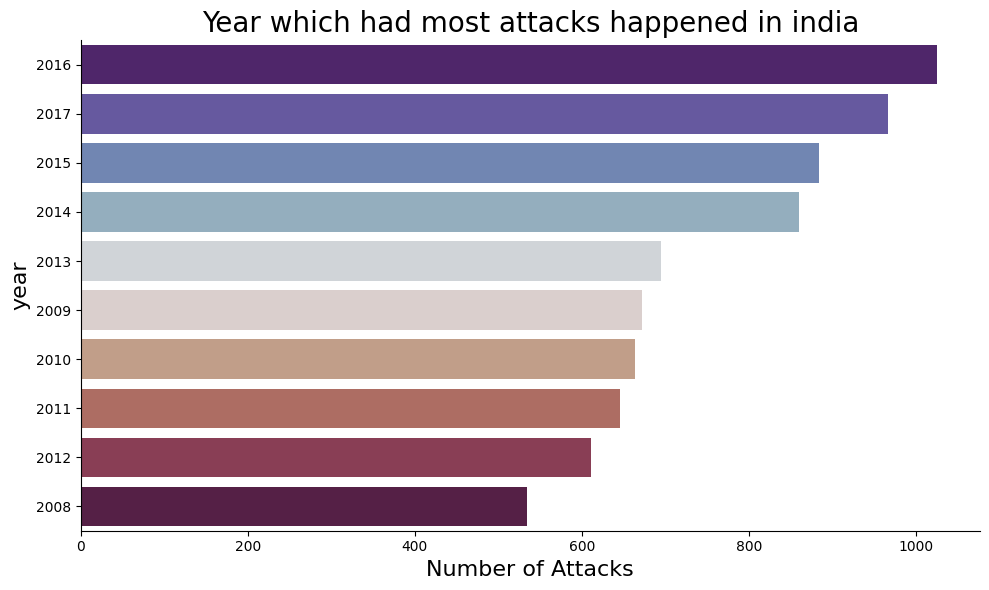

In [ ]:

plt.figure(figsize=(10, 6))
sns.countplot(y=india_data['Year'], palette='twilight_shifted', order=india_data['Year'].value_counts().head(10).index)
plt.title('Year which had most attacks happened in india',fontsize=20)
plt.xlabel('Number of Attacks',fontsize=16)
plt.ylabel('year',fontsize=16)
sns.despine()
plt.tight_layout()
plt.show()


**The Year of 2016,2017 followed by 2015,2014 suffered the most attacks in India**

---

## **Favrable city of terrorist to attack**

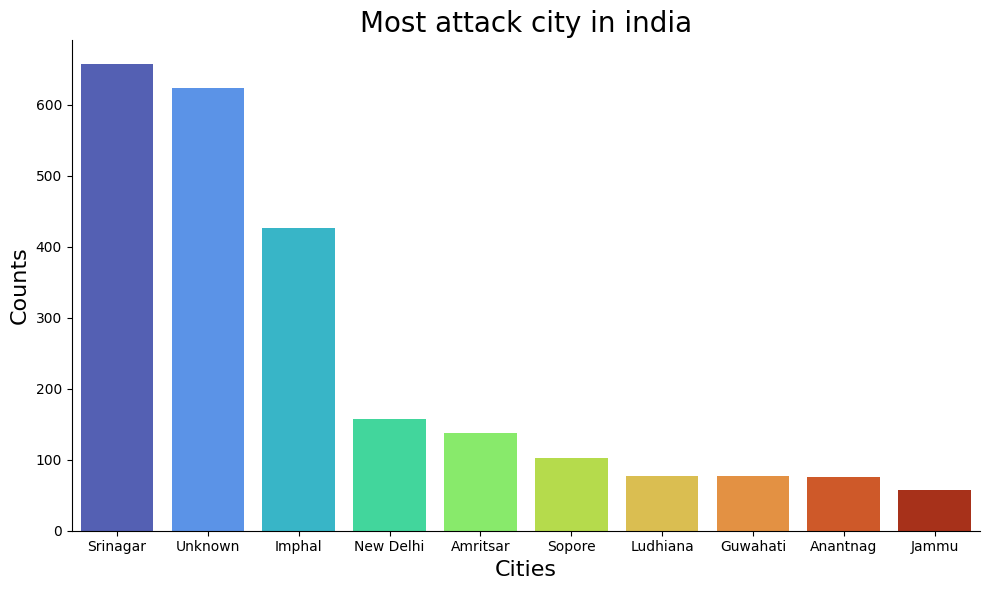

In [ ]:
india_city=india_data['city'].value_counts().head(10)
plt.figure(figsize=(10,6))
sns.barplot(x=india_city.index,y=india_city,palette='turbo')
plt.title('Most attack city in india',fontsize=20)
plt.xlabel('Cities',fontsize=16)
plt.ylabel('Counts',fontsize=16)
sns.despine()
plt.tight_layout()
plt.show()


**Srinagar, Imphal and New Delhi are the favourite cities of terrorists to attack**

---

## **People Killed compare to Attacks**

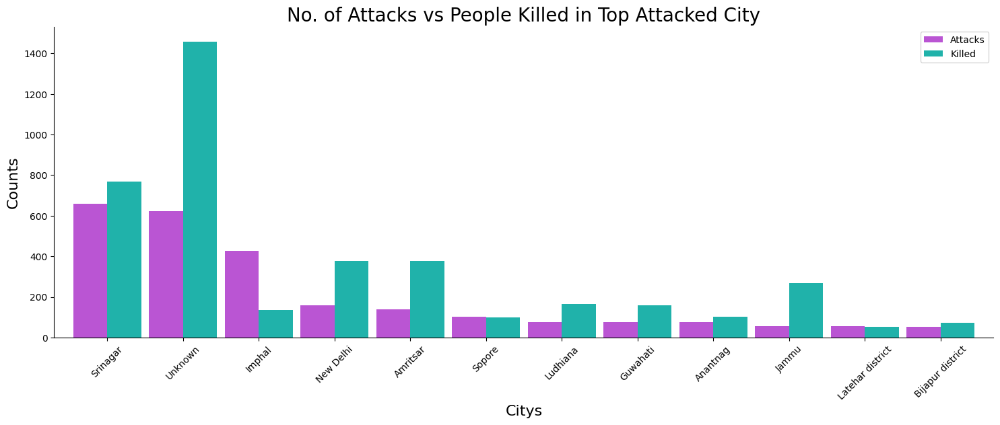

In [ ]:
india_terror = india_data['city'].value_counts()[:12].to_frame()
india_terror.columns = ['Attacks']
india_kill = india_data.groupby('city')['Killed'].sum().to_frame()

merged_data = india_terror.merge(india_kill, left_index=True, right_index=True, how='left')
merged_data.plot(kind='bar', y=['Attacks', 'Killed'], width=0.9, figsize=(18, 6),color=['mediumorchid', 'lightseagreen'])
plt.title('No. of Attacks vs People Killed in Top Attacked City',fontsize=20)
plt.xticks(rotation=45)
plt.xlabel('Citys',fontsize=16)
plt.ylabel('Counts',fontsize=16)
sns.despine()
plt.show()

**Srinagar has the most people killed as the terrorist attack rate is also high.
Compared to attacks there are fewer people killed in Imphal on the other hand New Delhi, Amritsar and Jammu have more people killed compared to others.**

---

## **On which Target and Target type the most damage was done?**

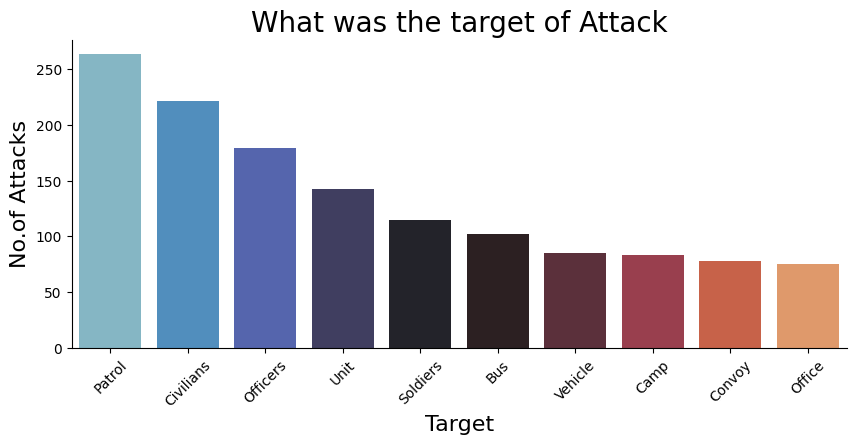

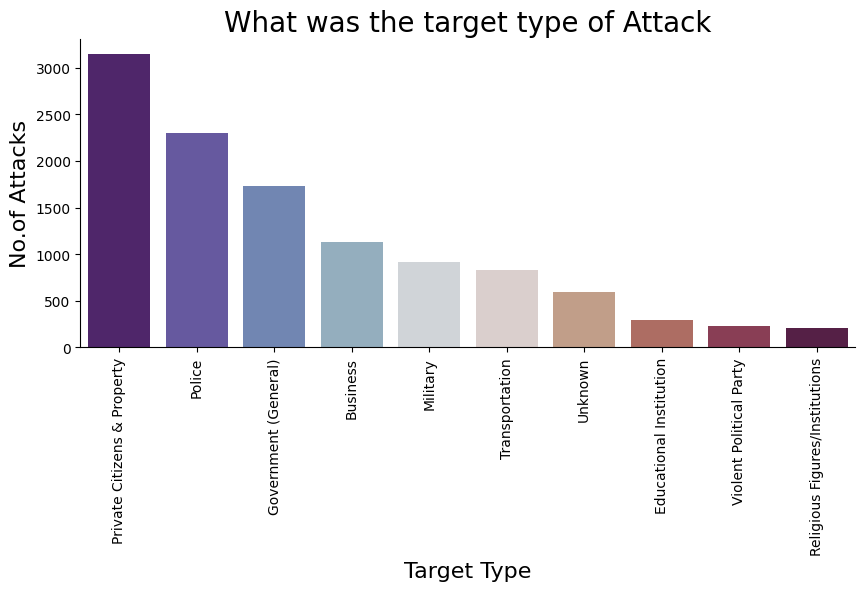

In [ ]:
india_target=india_data['Target'].value_counts()[1:11]
plt.figure(figsize=(10,4))
sns.barplot(x=india_target.index,y=india_target,palette='icefire')
plt.title('What was the target of Attack',fontsize=20)
plt.xlabel('Target',fontsize=16)
plt.ylabel('No.of Attacks',fontsize=16)
plt.xticks(rotation=45)
sns.despine()

plt.show()

india_tar_type=india_data['Target_type'].value_counts().head(10)
plt.figure(figsize=(10,4))
sns.barplot(x=india_tar_type.index,y=india_tar_type,palette='twilight_shifted')
plt.title('What was the target type of Attack',fontsize=20)
plt.xlabel('Target Type',fontsize=16)
plt.ylabel('No.of Attacks',fontsize=16)
plt.xticks(rotation=90)
sns.despine()

plt.show()

**The bar plot reveals that the most common targets of terrorist attacks in India include civilians, followed by security forces and government officials.**

**Analysis of target types indicates that private citizens and property are the primary targets, followed by military personnel and police forces, emphasizing the diverse nature of attacks in India**

---

## **Most Active Terrorists group in India**

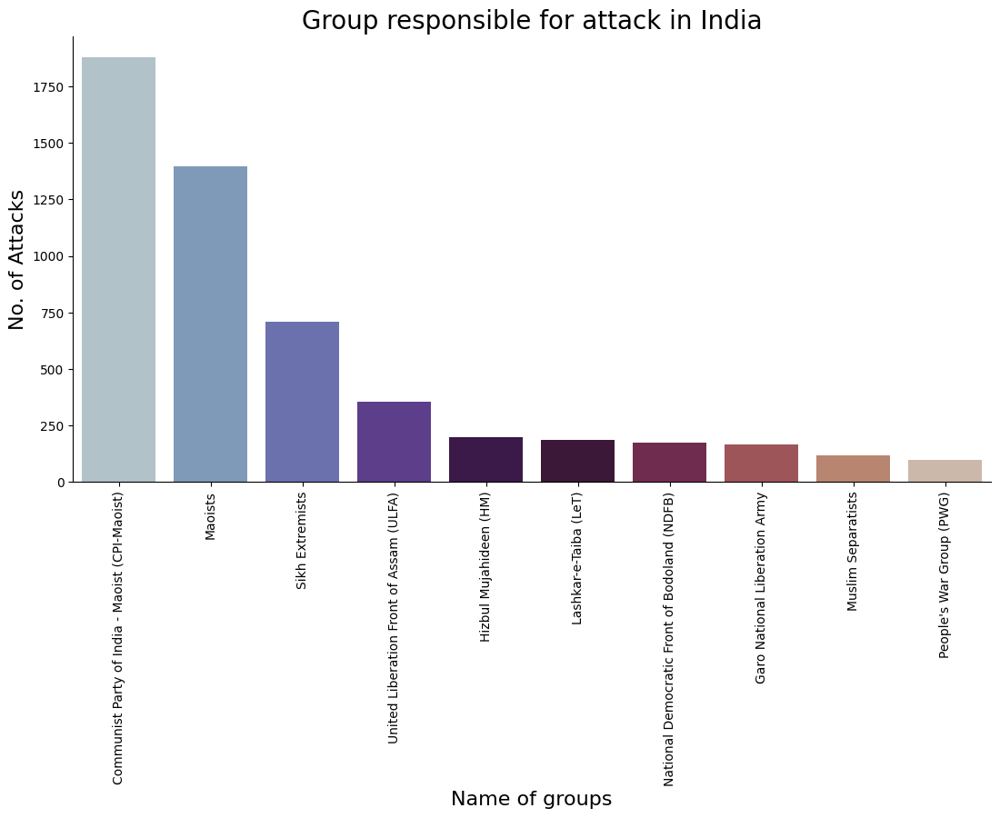

In [ ]:
india_group=india_data['Group'].value_counts()[1:11]
plt.figure(figsize=(12, 6))
sns.barplot(x=india_group.index,y=india_group,palette='twilight')
plt.title('Group responsible for attack in India',fontsize=20)
plt.xlabel('Name of groups',fontsize=16)
plt.ylabel('No. of Attacks',fontsize=16)
sns.despine()
plt.tight_layout()
plt.xticks(rotation=90)
plt.show()

**Group responsible for most of the Attack in India is Communist Party of india (CPI-Maoist), Maoists and Sikh Extremists**

***

## **Most preferred way of attack by terrorists on India**

Text(0.5, 1.0, 'What type of Attack was mostly done in india')

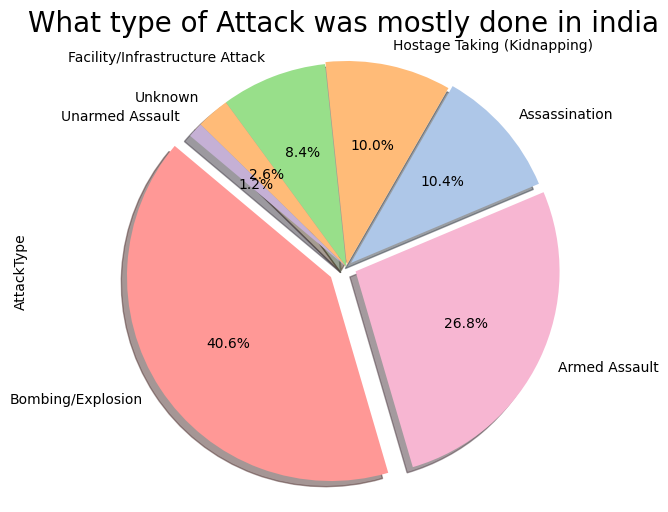

In [ ]:
plt.figure(figsize=(8, 6))
colors =['#ff9896', '#f7b6d2', '#aec7e8', '#ffbb78', '#98df8a', '#ffbb78', '#c5b0d5']
explode = (0.09, 0.05, 0.03, 0.01, 0, 0, 0)
india_data['AttackType'].value_counts().head(7).plot.pie(autopct='%1.1f%%',colors=colors,shadow=True,startangle=140,explode=explode)
plt.axis('equal')
plt.title('What type of Attack was mostly done in india',fontsize=20)

**Bombing/Explosion, Armed Assault and Assassination are the most preferred way of attack by terrorists in India.**

---

## **Most frequently used weapons by Terrorists in India**

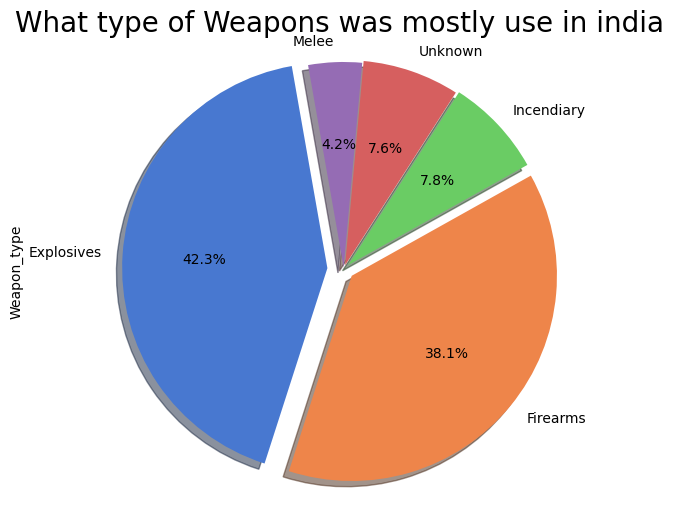

In [ ]:
plt.figure(figsize=(8, 6))
explode = (0.08,0.05,0.03,0.02,0.01)
india_data['Weapon_type'].value_counts().head(5).plot.pie(autopct='%1.1f%%',explode=explode,shadow=True,startangle=100)
plt.axis('equal')
plt.title('What type of Weapons was mostly use in india',fontsize=20)
plt.show()

**Explosives, Firearms and Incendiary are the most frequently used weapons by terrorists.**

---

## **Visualizing Terrorist Incidents Across Indian Cities**

In [ ]:
hover_text = india_data.apply(lambda row: f'In year {row["Year"]} an Attack on {row["city"]} happened by {row["Group"]} in which {row["casualities"]} casualties were there', axis=1)
fig = px.scatter_mapbox(india_data, lat='latitude', lon='longitude', hover_name=hover_text,
                        zoom=5, height=600)

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

**This visualization provides a geographical overview of terrorist incidents across various Indian cities. It highlights the locations, groups involved, and casualty counts, offering insights into the distribution and impact of terrorism within India.**

---

# **Conclusion**


* Trends Over Time:

 * The number of terrorist attacks globally has fluctuated over the years, with a noticeable increase from the late 2000s onwards.
 * The years 2014, 2015, and 2016 saw the highest number of attacks consecutively.
* Casualties Analysis:

 * Casualties per year increased alongside the rise in attacks, peaking around the years 2014 and 2015.
 * This indicates a correlation between the frequency of attacks and the number of casualties.
* Attack Methods and Weapons:

 * Bombings are the most prevalent method of attack globally, followed by armed assaults and assassinations.
 * Explosives and firearms are the most commonly used weapons in terrorist attacks.
* Region-wise Analysis:

 * Different regions exhibit varying patterns of terrorist activity, influenced by geopolitical factors, ethnic tensions, and historical conflicts.
 * The Middle East and North Africa region have historically been hotspots for terrorist incidents, particularly bombings, due to ongoing conflicts and political instability.
* Target Types:

 * Private citizens/property are the most frequently targeted, followed by military personnel, police, and government officials.
* Top Attacked Countries:

 * Iraq, Pakistan, and Afghanistan are among the countries with the highest number of terrorist attacks and casualties.
 * Nigeria surprisingly has more casualties than India and other countries, despite fewer reported attacks.

* Analysis of Terrorist Groups:

 * Understanding the motivations and objectives of terrorist groups is essential for devising effective counter-terrorism strategies.
 * The dataset provides insights into the diverse range of terrorist organizations operating globally, including  well-known groups like Taliban ,ISIS and Al-Qaeda, as well as lesser-known local insurgent groups with specific regional agendas.

* India-Specific Analysis:

 * India has faced significant terrorist activity, with fluctuations in attacks over the years.
 * Analysis of target types indicates a diverse range of targets, including civilians, security forces, and government officials.
 * Specific regions within India may experience higher rates of terrorist incidents, requiring localized counter-terrorism strategies.
 * The modus operandi of terrorist attacks in India often involves the use of explosives, firearms, and incendiary devices.
 * Urban centers and densely populated areas are more susceptible to terrorist attacks, necessitating enhanced security measures and vigilance.
* Impact Visualization:

 * Mapping terrorist incidents across Indian cities provides a visual representation of the geographical distribution of attacks and their impact on different regions.
* Recommendations for Counter-Terrorism Strategies:

 * Collaborative efforts between government agencies, law enforcement, intelligence services, and international partners are essential to combat terrorism effectively.
 * Enhanced surveillance, intelligence gathering, and information sharing mechanisms can help identify and thwart potential terrorist threats.
 * Investment in community engagement, deradicalization programs, and socioeconomic development initiatives can address root causes of terrorism and prevent radicalization.
* Conclusion:

 * The analysis underscores the complex nature of global terrorism, with specific insights into India's experience.
 * Counter-terrorism efforts must adopt a multifaceted approach, integrating security measures, diplomatic efforts, and socioeconomic development strategies.
 * Continued research and analysis are crucial for understanding evolving terrorist tactics, identifying vulnerabilities, and formulating effective counter-terrorism policies.





***

### ***Hurrah! You have successfully completed your EDA Capstone Project !!!***

***